In [1]:
%pylab --no-import-all
%matplotlib inline
from sacla import *

Using matplotlib backend: agg
Populating the interactive namespace from numpy and matplotlib


In [2]:
import idi.reconstruction as recon
import idi.util as util

In [3]:
l=log('2019 SACLA - Shotlog.csv')

In [4]:
import pandas as pd
pd.set_option('display.max_rows', 1000)

In [5]:
import glob
import os
def getlatest(search_dir=".",pattern='*',n=1):
    files = list(filter(os.path.isfile, glob.glob(search_dir +'/'+ pattern)))
    files = sorted(files,key=os.path.getmtime,reverse=True)[:n]
    if len(files)==1: return files[0]
    if len(files)==0: return None
    else: return tuple(files)
    
def append(dictionary,key,value):
    if not key in dictionary:
        dictionary[key]=[]
    dictionary[key].append(value)

In [6]:
l.iloc[:40,:]

,Run start,last run,Starttime,Endtime,Sample,E_ph,Pre Comment,Pulse Energy,Detector Filter,Beamline filter,...,Sx speed,Sz min,Sz max,Sz spacing,Single_x,Single_y,Single_z,Prof_Y,Prof_X2,Prof_Z1
,#,#,Time,Time,#/desc,keV,desc,uJ,desc,mm Silicon,...,pulse/sec,pulses,pulses,pulses,microns,microns,microns,microns,microns,microns
0,781931,NaN,05:47:29,NaN,1,10.4,NaN,562.0,50um Zink,0.3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,781932,781952.0,09:20:14,09:29:08,15,10.4,background,570.0,50um Zink,0.4,...,1200.0,-10000.0,10000.0,80.0,6182.0,-5897.0,1500.0,3715.0,-1100.0,NaN
2,781953,781959.0,09:30:16,09:31:57,15,10.4,NaN,570.0,50um Zink,0.3,...,1200.0,-10000.0,10000.0,80.0,6182.0,-5897.0,1500.0,3715.0,-1100.0,NaN
3,781960,781965.0,09:35:57,09:31:57,15,10.4,NaN,570.0,50um Zink,0.4,...,3600.0,-3000.0,10000.0,80.0,6182.0,-5897.0,1500.0,3715.0,-1100.0,NaN
4,781966,781975.0,09:39:18,09:42:37,15,10.4,NaN,570.0,50um Zink,0.5,...,1200.0,-3000.0,10000.0,80.0,6182.0,-5897.0,1500.0,3715.0,-1100.0,NaN
5,781976,781985.0,09:50:41,09:42:37,22x17 empty,10.4,empty 22x17 window,570.0,50um Zink,0.3,...,1200.0,-3000.0,10000.0,80.0,6182.0,-5897.0,1500.0,3715.0,-1100.0,NaN
6,781976,781985.0,09:50:41,09:42:37,none,10.4,NaN,570.0,50um Zink,0.3,...,1200.0,-3000.0,10000.0,80.0,6182.0,-5897.0,1500.0,3715.0,-1100.0,NaN
7,781976,781985.0,09:50:41,09:42:37,none,10.4,Stephan shielded from air scattering after tar...,570.0,50um Zink,0.3,...,1200.0,-3000.0,10000.0,80.0,6182.0,-5897.0,1500.0,3715.0,-1100.0,NaN
8,781976,781985.0,09:50:41,09:42:37,none,10.4,Tais shieded detector from upstream,570.0,50um Zink,0.3,...,1200.0,-3000.0,10000.0,80.0,6182.0,-5897.0,1500.0,3715.0,-1100.0,NaN


In [7]:
!ls /work/gorkhover/zimmf/kossel/

18_782025.h5  23_782075.h5  27_782164.h5  32_782209.h5	35_782273.h5
18_782026.h5  23_782076.h5  27_782165.h5  32_782210.h5	35_782274.h5
18_782027.h5  23_782077.h5  29_782167.h5  32_782211.h5	35_782275.h5
18_782028.h5  23_782078.h5  29_782168.h5  32_782212.h5	35_782276.h5
18_782029.h5  23_782079.h5  29_782169.h5  33_782240.h5	35_782277.h5
18_782030.h5  23_782080.h5  29_782170.h5  33_782241.h5	35_782278.h5
19_782066.h5  24_782095.h5  31_782181.h5  33_782242.h5	36_782295.h5
19_782067.h5  24_782096.h5  31_782182.h5  33_782243.h5	36_782296.h5
19_782068.h5  24_782097.h5  31_782183.h5  33_782244.h5	36_782297.h5
19_782069.h5  24_782098.h5  31_782184.h5  33_782245.h5	36_782298.h5
20_782070.h5  24_782099.h5  31_782185.h5  34_782268.h5	36_782299.h5
20_782071.h5  24_782100.h5  31_782186.h5  34_782269.h5	36_782300.h5
20_782072.h5  27_782162.h5  32_782207.h5  34_782270.h5	out
20_782073.h5  27_782163.h5  32_782208.h5  34_782271.h5	out2


In [29]:
selected=[18, 19, 20, 23, 24, 27, 29, 31, 33, 35]
selected=[32]#, 34, 36]

In [12]:
import os

In [13]:

import gc
import shutil
import os
def submit(r):
    run=str(r.name)
    print(run)
    runstart=int((r['Run start'][0]))
    runend=int(r['last run'][0])
    for cr in range(runstart,min(runend,runstart+6)):
        print(cr)
        if not os.path.isfile(f'/work/gorkhover/zimmf/kossel/{run}_{cr}.h5'):
            shutil.copyfile(f'/UserData/gorkhover/TAIS2019/{cr}.h5', f'/work/gorkhover/zimmf/kossel/{run}_{cr}.h5')
            print('copied')
for r in selected:
    runs=l.iloc[r].to_frame()
    runs.apply(submit,axis=0)

18
782025
782026
782027
copied
782028
782029
782030
19
782066
782067
782068
20
782070
782071
782072
782073
23
782075
782076
782077
782078
782079
782080
24
782095
782096
782097
782098
782099
782100
27
782162
782163
782164
29
31
782181
782182
782183
782184
782185
782186
33
782240
782241
782242
782243
782244
782245
35
782273
782274
782275
782276
782277
782278
32
782207
782208
782209
782210
782211
782212
34
782268
782269
782270
782271
36
782295
782296
782297
782298
782299
782300


In [14]:
samplenames={
18: 'GaN 500nm',
19: 'GaAs 500um flat down',
20: 'GaAs 500um flat sideways',
23: 'GaAs 5um',
24: 'GaAs 5um 45deg',
27: 'GaNCrystal 50um edge lower left',
29: 'GaNCrystal 50um edge lower right',
31: 'GaAs 5um 45deg',
32: 'GaAs 5um 45deg',
33: 'GaN 500nm',
34: 'GaN 500nm',
35: 'GaAs 5um 30deg',
36: 'GaAs 5um 30deg'
}

In [15]:
import scipy.ndimage as snd

def diffdist(*args):
    accum = 0
    for arg in args:
        accum += np.diff(arg) ** 2
    return np.sqrt(accum)


def getbg(detector):
    accum = util.accumulator()
    for img in detector:
        dat = np.array(img) * detector.absolute_gain * 3.65
        hits = dat > 2000
        empty = ~(snd.morphology.binary_dilation(hits, snd.morphology.generate_binary_structure(2, 2)))
        accum.add(dat * empty.astype(float), empty)
    return accum.mean

def photonize(img, energy, gain=1, bg=0):
    return np.rint( toev(img, gain, bg)/ energy)

def toev(img, gain=1, bg=0):
    return ((np.squeeze(np.array(img)) * gain * 3.65) - bg)

def photonsstats(detector, bg, energy, thres=0):
    accum = util.accumulator()
    photonsum = []
    maxphotons = 0
    for n, img in enumerate(detector):

        photons = photonize(img, energy, detector.absolute_gain, bg)
        ps = np.sum(photons)
        if ps > thres:
            accum.add(photons)
            maxphotons = np.maximum(maxphotons, photons)
        photonsum.append(ps)
    return (accum.mean, accum.std, maxphotons, np.array(photonsum))

In [15]:
!mkdir -p /work/gorkhover/zimmf/kossel/out/

In [ ]:
import tables
def analysis(run,cr):
    if os.path.isfile(f'/work/gorkhover/zimmf/kossel/out/{run}_{cr}.h5'):
        print(f'output exists for {run}_{cr}. skipping')
        return
    hdf5_file = tables.open_file(f'/work/gorkhover/zimmf/kossel/out/{run}_{cr}.h5', mode='w') 
    FILTERS = tables.Filters(complib='zlib', complevel=5)

    r=saclarun(f'/work/gorkhover/zimmf/kossel/{run}_{cr}.h5',settings=Tais2019)
    print(f'{len(r)} images')
    detector = r.detector_2d_1
    energy = 9250

    motors = hdf5_file.create_group("/", 'motors', 'motor information')
    for motor in ['BeamstopX',
     'BeamstopZ',
     'DualThx',
     'DualX',
     'DualZ',
     'HccdX',
     'HccdZ',
     'PDX',
     'SingleThy',
     'SingleThz',
     'SingleX',
     'SingleY',
     'SingleZ',
     'profX2',
     'profY',
     'profZ1',
     'sampleThX',
     'sampleThY',
     'sampleThZLower',
     'sampleThZUpper',
     'sampleX',
     'sampleZ']:
        x=getattr(r,motor)
        atom = tables.Atom.from_dtype(x.dtype)
        ds = hdf5_file.create_array(motors, motor, atom=atom, shape=x.shape)
        ds[:] = x

    meta = hdf5_file.create_group("/", 'meta', 'meta information')
    dictmeta={'attn_Si_mm':l.iloc[run]['Beamline filter'][0],
        'sample':samplenames[run],
        'energy':r.photonenergy,
        'run':r.run,
        'logrow':run,
        'detector_filter':l.iloc[run]['Detector Filter'][0]}
    for k,v in dictmeta.items(): 
        atom = tables.Atom.from_dtype(np.array(v).dtype)
        ds = hdf5_file.create_array(meta, k, atom=atom,shape=(1,))
        ds[:] = np.array(v)    
        
           
    g_shots = hdf5_file.create_group("/", 'data', 'data')
    d_raw = hdf5_file.create_earray(g_shots,'detector_raw',tables.Float32Atom(), (0,1024,512),expectedrows=5000,chunkshape=(1,1024,512),filters=FILTERS)
    d_raw.attrs.ev_per_adu=detector.absolute_gain * 3.65
    d_photons = hdf5_file.create_earray(g_shots,'detector_simplephotons',tables.UInt8Atom(), (0,1024,512),expectedrows=5000,chunkshape=(1,1024,512),filters=FILTERS)
    
    bg = getbg(detector)
    print('bg done',flush=True)
    setdist = np.percentile(diffdist(r.sampleX), 75)
    mindist = setdist * 0.7
    distok = np.concatenate(([0], diffdist(r.sampleX, r.sampleZ))) > mindist
    print(f'dist: {np.sum(distok)} /{len(distok)}')
    beamok=(r.pulse_energy_hutch_joule>np.mean(r.pulse_energy_hutch_joule)-2*np.std(r.pulse_energy_hutch_joule))
    shots = r[np.logical_and(distok,beamok)]
    tmpdetector = getattr(shots, 'detector_2d_1')
    meanphotons, stdphotons, maxphotons, photonsum = photonsstats(tmpdetector, bg, energy, 100)
    nphotonsmin = np.rint(np.percentile(photonsum, 10))
    nphotonsmax = np.rint(np.percentile(photonsum, 99))
    intok = np.logical_and.reduce((photonsum > 100, nphotonsmin < photonsum, photonsum < nphotonsmax))
    isgood=np.logical_and(distok,beamok)
    isgood[isgood][~intok]=False
    print('done filtering',flush=True)

    photoncount=[]
    accum=util.accumulator()
    for n,img in enumerate(detector):
        img=np.array(img)
        d_raw.append(img[None])
        if isgood[n]:
            photons=photonize(img,energy,detector.absolute_gain,bg)
            d_photons.append((np.clip(photons,0,255).astype(np.uint8))[None])
            accum.add(photons)
            photoncount.append(np.sum(photons))
        if n%100==0: print(n,end=' ',flush=True)
    mean=accum.mean
    photoncount=np.array(photoncount)
    lowpassmean=snd.gaussian_filter(mean,20)
    mean_simplebg=((mean-lowpassmean)/lowpassmean)

    ds = hdf5_file.create_array(g_shots, 'isgood', atom=tables.Atom.from_dtype(isgood.dtype), shape=isgood.shape)
    ds[:] = isgood

    ds = hdf5_file.create_array(g_shots, 'photoncount', atom=tables.Atom.from_dtype(photoncount.dtype), shape=photoncount.shape)
    ds[:] = photoncount

    ds = hdf5_file.create_array(g_shots, 'mean', atom=tables.Atom.from_dtype(mean.dtype), shape=mean.shape)
    ds[:] = mean
    
    ds = hdf5_file.create_array(g_shots, 'mean_simplebg', atom=tables.Atom.from_dtype(mean_simplebg.dtype), shape=mean_simplebg.shape)
    ds[:] = mean_simplebg
    print('closing')
    hdf5_file.close()

In [27]:
import tables
def analysis(run,cr):
    r=saclarun(f'/work/gorkhover/zimmf/kossel/{run}_{cr}.h5',settings=Tais2019)
    f=h5py.File(f'/work/gorkhover/zimmf/kossel/out/{run}_{cr}.h5','r')
    print(f.keys())
    photoncount=f['data']['photoncount']
    mean_simplebg=f['data']['mean_simplebg']
    photons=list(np.round((np.min(photoncount),np.mean(photoncount),np.max(photoncount)),decimals=-1).astype(int))
    dictmeta={'attn_Si_mm':l.iloc[run]['Beamline filter'][0],
        'sample':samplenames[run],
        'photonenergy':np.rint(r.photonenergy),
        'run':r.run,
        'logrow':run,
        'detector_filter':l.iloc[run]['Detector Filter'][0],
        'photoncount':photons}
    with open(f'/work/gorkhover/zimmf/kossel/out/{run}_{cr}.txt', 'w') as infofile:
        for k,v in dictmeta.items():
            infofile.write(f'{k}: {v}\n') 
    vmax=np.percentile(mean_simplebg[100:-100,100:-100],99)
    vmin=np.percentile(mean_simplebg[100:-100,100:-100],1)
    plt.matshow(mean_simplebg,vmin=vmin,vmax=vmax)
    plt.title(f'{run}_{cr}\n{samplenames[run]}')
    plt.savefig(f'/work/gorkhover/zimmf/kossel/out/{run}_{cr}.png')
    plt.close()
    f.close()

In [71]:
run=27
cr=782164
f=h5py.File(f'/work/gorkhover/zimmf/kossel/out/{run}_{cr}.h5','r')

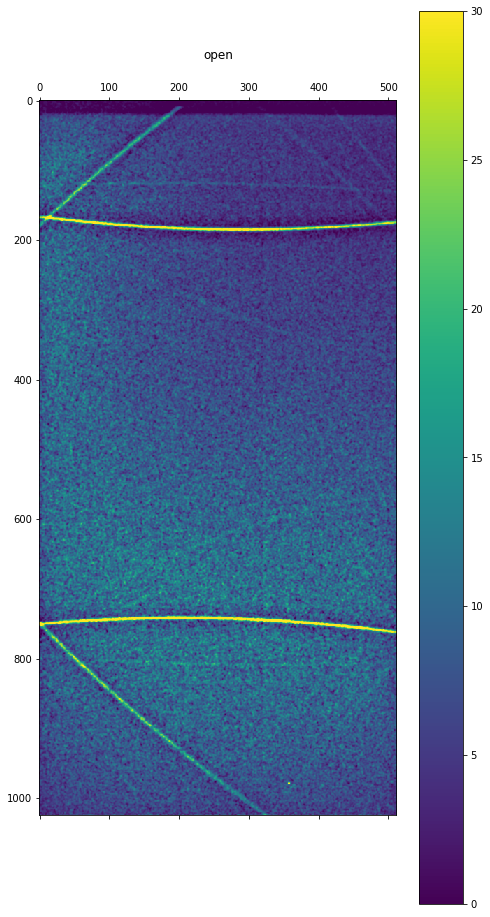

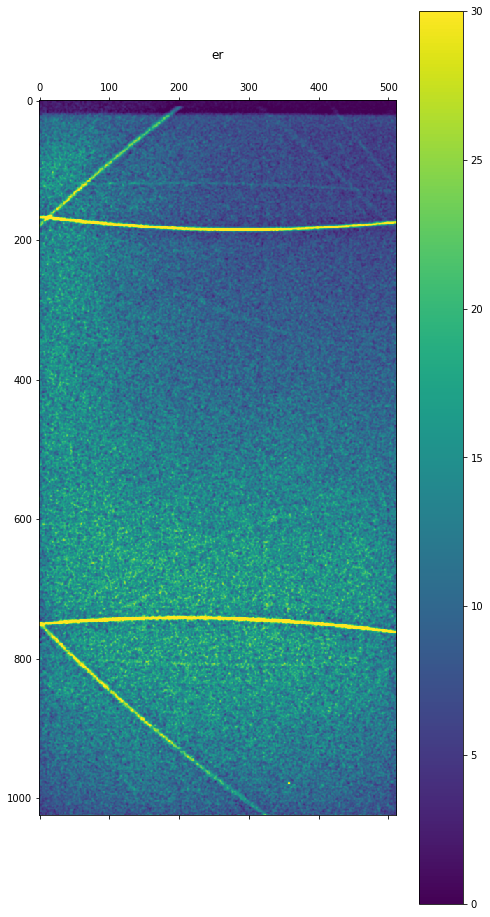

In [105]:
# plt.matshow(psum-snd.morphology.grey_closing(psum,size=s))
# plt.colorbar()
# plt.title('close')
# plt.show()
s=(4,4)
plt.matshow(snd.gaussian_filter(psum-snd.gaussian_filter(snd.morphology.grey_opening(psum,size=s),10),1),vmax=30,vmin=0)
plt.colorbar()
plt.title('open')
plt.show()


plt.matshow(snd.gaussian_filter(psum-snd.gaussian_filter(snd.morphology.grey_erosion(psum,size=s),10),1),vmax=30,vmin=0)
plt.colorbar()
plt.title('er')
plt.show()


# plt.matshow(psum-snd.morphology.grey_dilation(psum,size=s))
# plt.colorbar()
# plt.title('dil')
# plt.show()


18 782025
<KeysViewHDF5 ['data', 'meta', 'motors']>


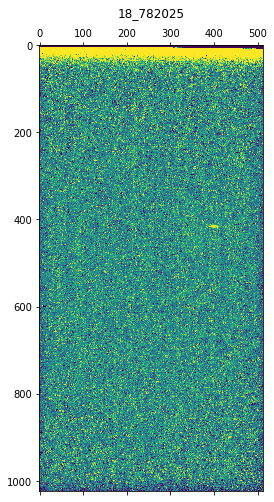

18 782026
<KeysViewHDF5 ['data', 'meta', 'motors']>


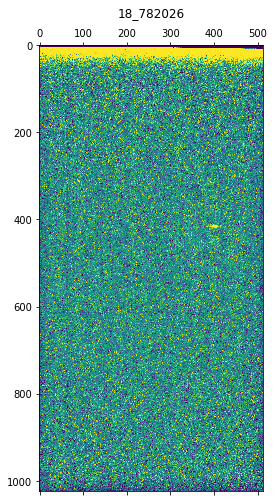

18 782027
<KeysViewHDF5 ['data', 'meta', 'motors']>


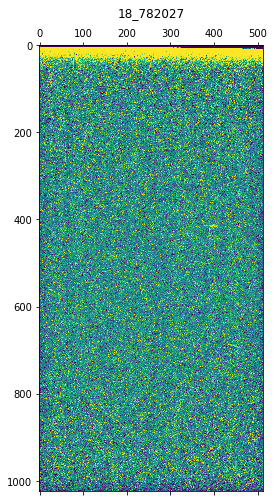

18 782028
<KeysViewHDF5 ['data', 'meta', 'motors']>


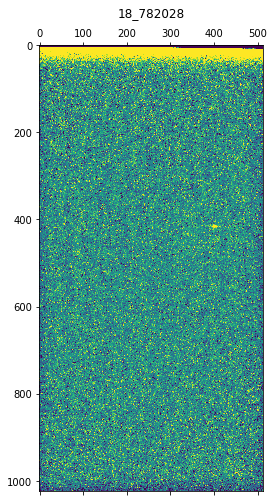

18 782029
<KeysViewHDF5 ['data', 'meta', 'motors']>


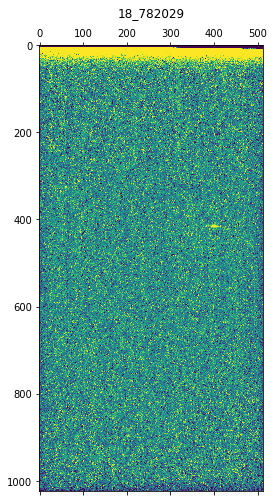

18 782030
<KeysViewHDF5 ['data', 'meta', 'motors']>


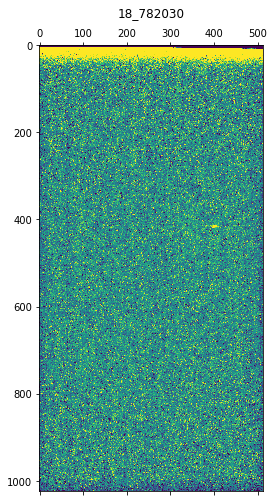

19 782066
<KeysViewHDF5 ['data', 'meta', 'motors']>


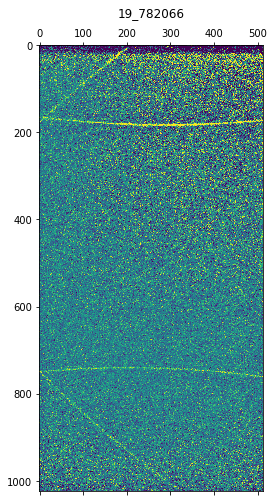

19 782067
<KeysViewHDF5 ['data', 'meta', 'motors']>


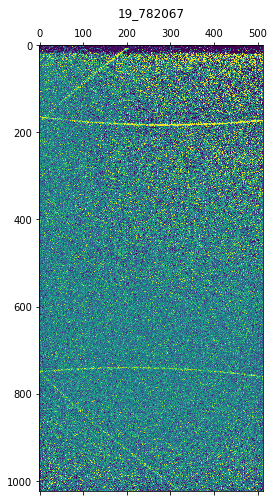

19 782068
<KeysViewHDF5 ['data', 'meta', 'motors']>


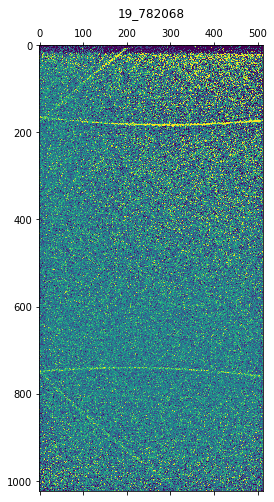

19 782069
<KeysViewHDF5 ['data', 'meta', 'motors']>


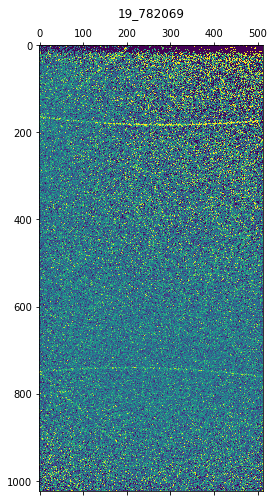

20 782070
<KeysViewHDF5 ['data', 'meta', 'motors']>


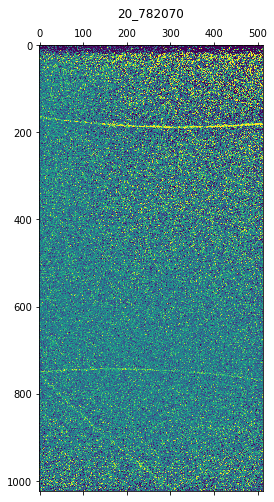

20 782071
<KeysViewHDF5 ['data', 'meta', 'motors']>


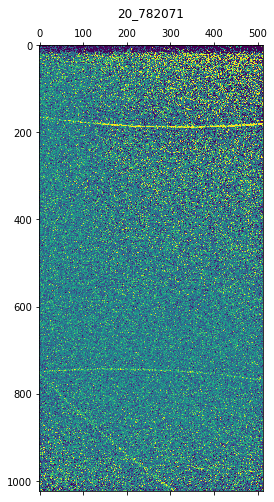

20 782072
<KeysViewHDF5 ['data', 'meta', 'motors']>


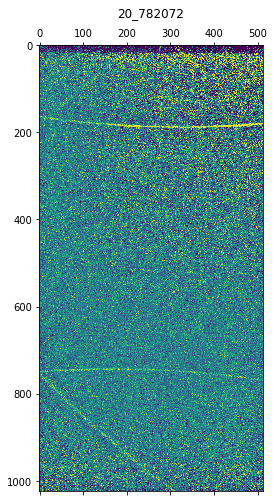

20 782073
<KeysViewHDF5 ['data', 'meta', 'motors']>


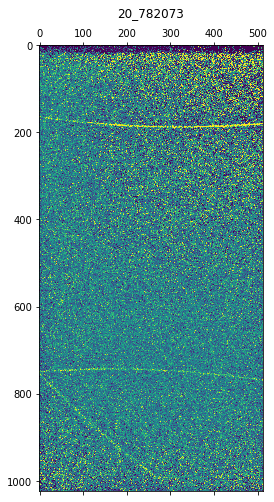

23 782075
<KeysViewHDF5 ['data', 'meta', 'motors']>


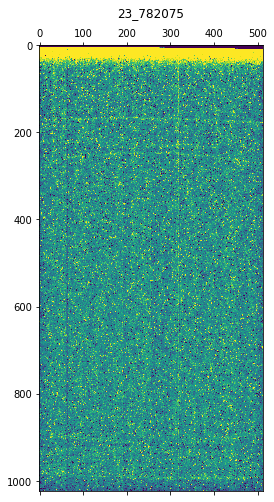

23 782076
<KeysViewHDF5 ['data', 'meta', 'motors']>


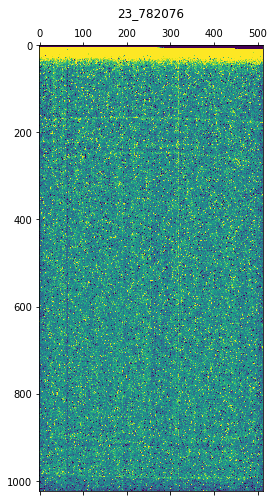

23 782077
<KeysViewHDF5 ['data', 'meta', 'motors']>


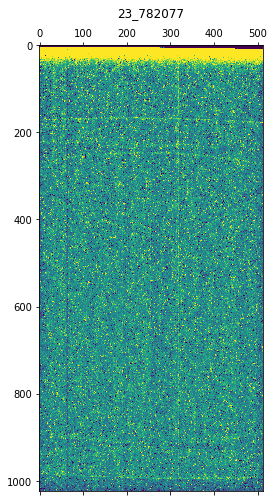

23 782078
<KeysViewHDF5 ['data', 'meta', 'motors']>


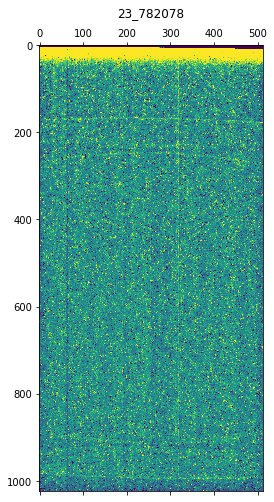

23 782079
<KeysViewHDF5 ['data', 'meta', 'motors']>


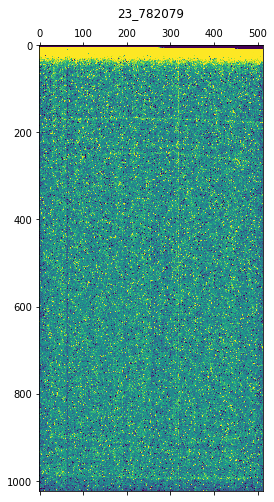

23 782080
<KeysViewHDF5 ['data', 'meta', 'motors']>


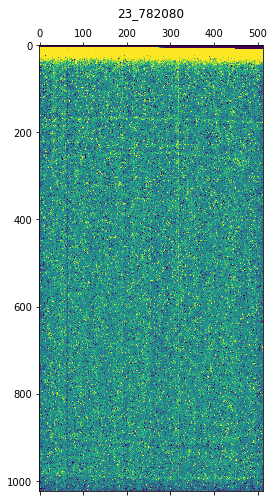

24 782095
<KeysViewHDF5 ['data', 'meta', 'motors']>


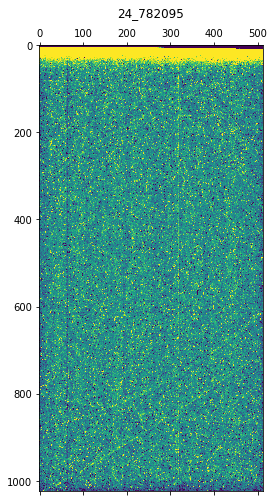

24 782096
<KeysViewHDF5 ['data', 'meta', 'motors']>


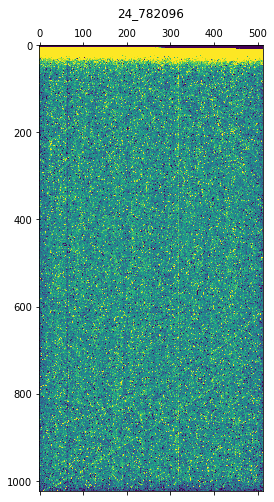

24 782097
<KeysViewHDF5 ['data', 'meta', 'motors']>


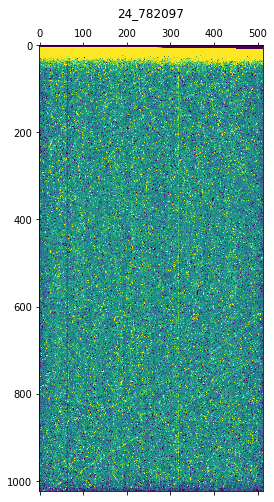

24 782098
<KeysViewHDF5 ['data', 'meta', 'motors']>


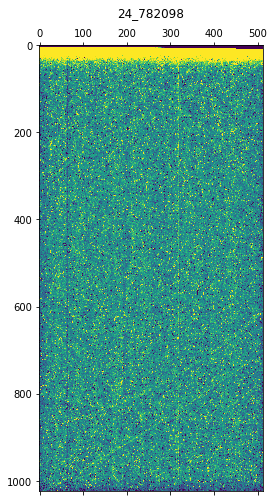

24 782099
<KeysViewHDF5 ['data', 'meta', 'motors']>


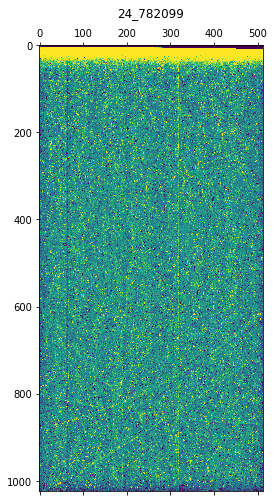

24 782100
<KeysViewHDF5 ['data', 'meta', 'motors']>


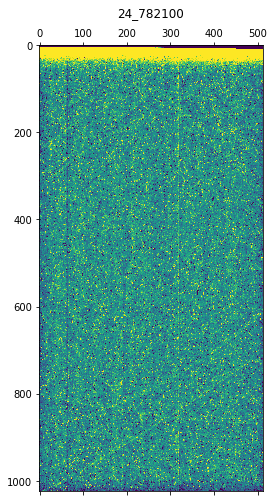

27 782162
<KeysViewHDF5 ['data', 'meta', 'motors']>


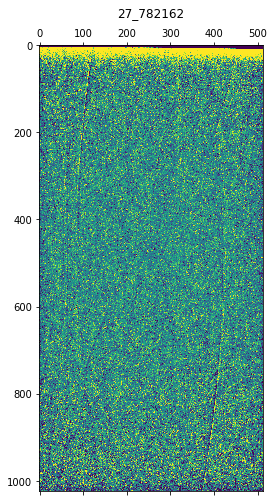

27 782163
<KeysViewHDF5 ['data', 'meta', 'motors']>


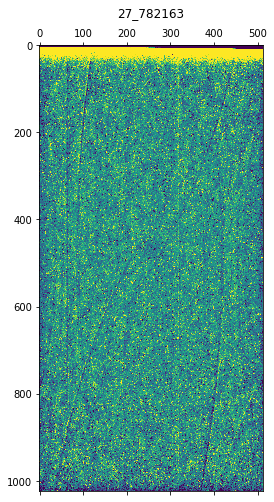

27 782165
<KeysViewHDF5 ['data', 'meta', 'motors']>


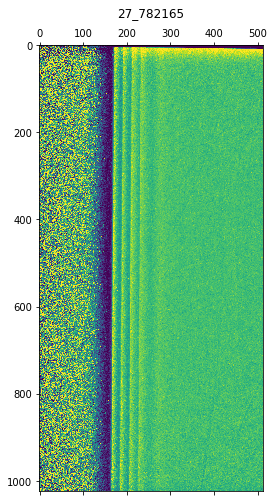

29 782167
<KeysViewHDF5 ['data', 'meta', 'motors']>


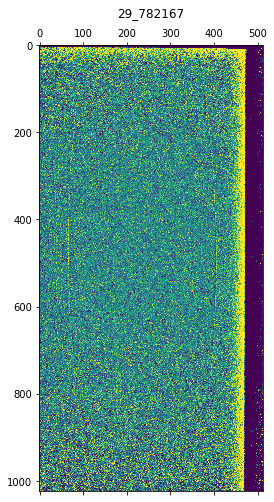

29 782168
<KeysViewHDF5 ['data', 'meta', 'motors']>


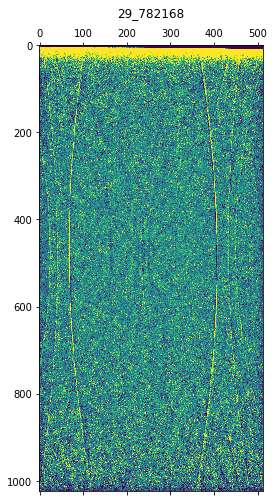

29 782169
<KeysViewHDF5 ['data', 'meta', 'motors']>


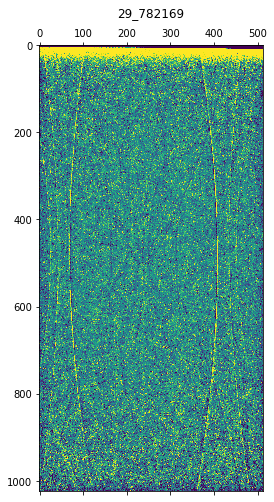

29 782170
<KeysViewHDF5 ['data', 'meta', 'motors']>


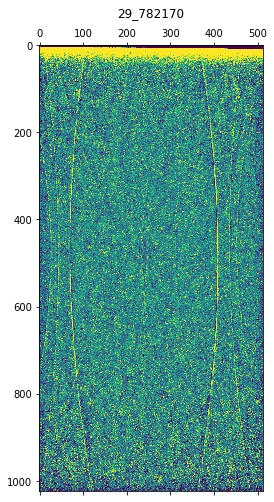

31 782181
<KeysViewHDF5 ['data', 'meta', 'motors']>


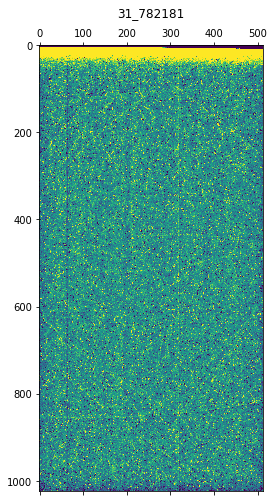

31 782182
<KeysViewHDF5 ['data', 'meta', 'motors']>


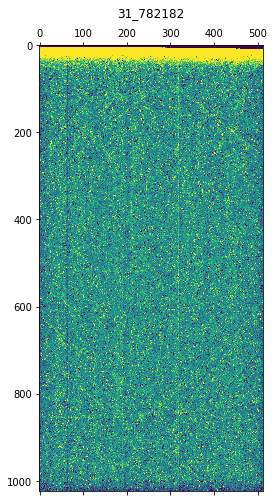

31 782183
<KeysViewHDF5 ['data', 'meta', 'motors']>


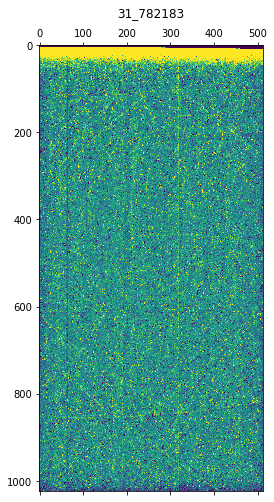

31 782184
<KeysViewHDF5 ['data', 'meta', 'motors']>


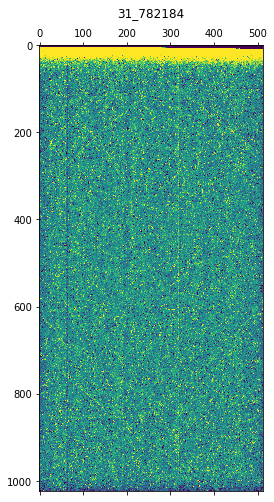

31 782185
<KeysViewHDF5 ['data', 'meta', 'motors']>


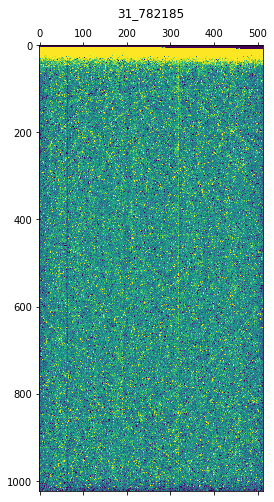

31 782186
<KeysViewHDF5 ['data', 'meta', 'motors']>


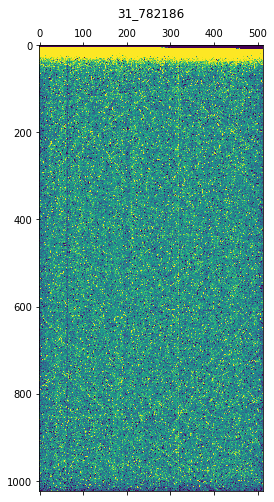

33 782240
<KeysViewHDF5 ['data', 'meta', 'motors']>


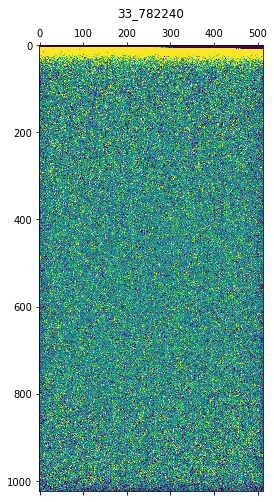

33 782241
<KeysViewHDF5 ['data', 'meta', 'motors']>


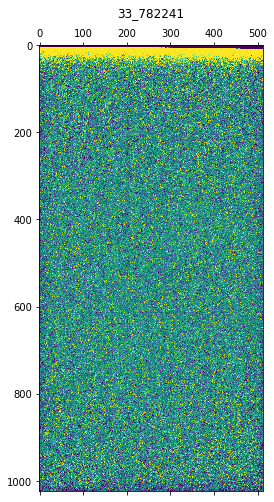

33 782242
<KeysViewHDF5 ['data', 'meta', 'motors']>


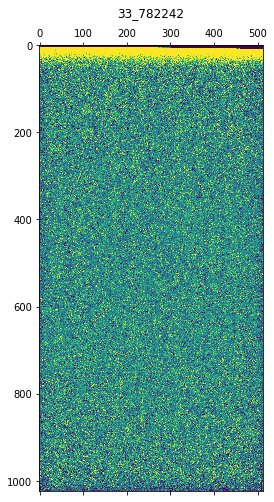

33 782243
<KeysViewHDF5 ['data', 'meta', 'motors']>


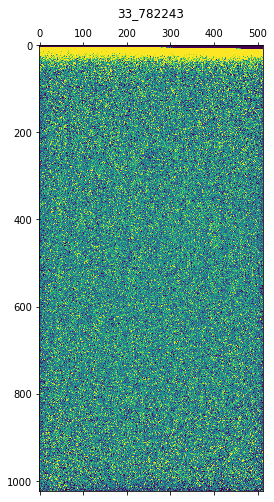

33 782244
<KeysViewHDF5 ['data', 'meta', 'motors']>


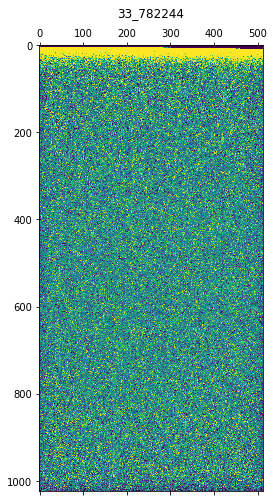

33 782245
<KeysViewHDF5 ['data', 'meta', 'motors']>


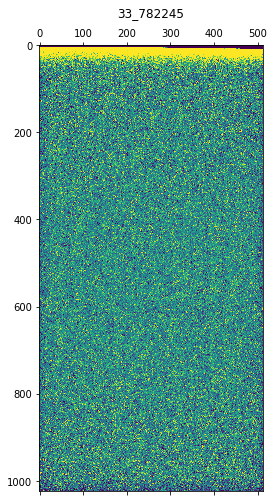

35 782273
<KeysViewHDF5 ['data', 'meta', 'motors']>


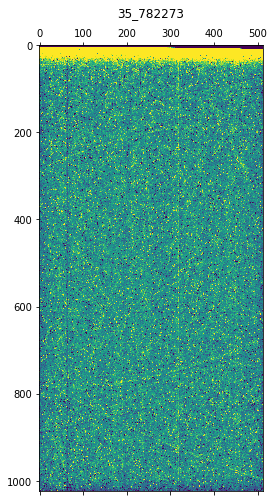

35 782274
<KeysViewHDF5 ['data', 'meta', 'motors']>


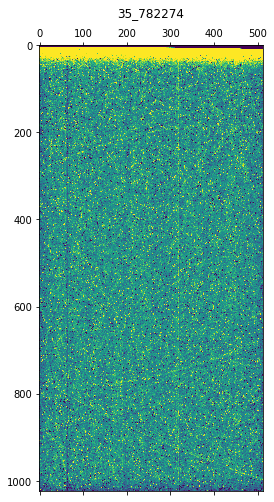

35 782275
<KeysViewHDF5 ['data', 'meta', 'motors']>


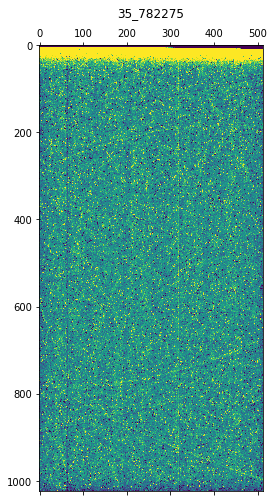

35 782276
<KeysViewHDF5 ['data', 'meta', 'motors']>


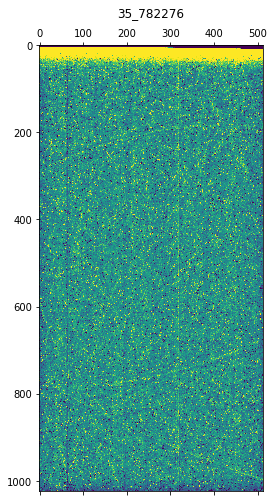

35 782277
<KeysViewHDF5 ['data', 'meta', 'motors']>


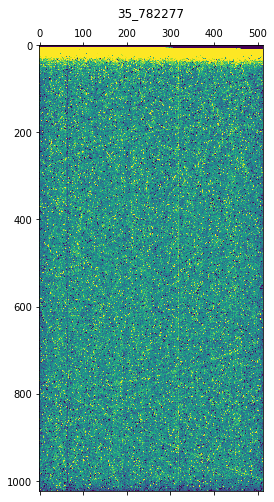

35 782278
<KeysViewHDF5 ['data', 'meta', 'motors']>


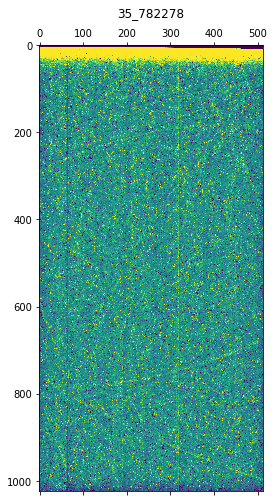

In [204]:
import glob
import re
files=sorted(glob.glob("/work/gorkhover/zimmf/kossel/out/*.h5"))
for f in files:
    run=int(re.split('(.*)(out/)([0-9]*)_([0-9]*).*',f)[3])
    cr=int(re.split('(.*)(out/)([0-9]*)_([0-9]*).*',f)[4])
    print(run,cr)
    analysis(run,cr)

In [ ]:
#writing index.html
path='./public_html/'

intro='''
<!DOCTYPE html>
<html>
<head>
<meta name="viewport" content="width=device-width, initial-scale=1">
<style>
.collapsible {
  background-color: #777;
  color: white;
  cursor: pointer;
  padding: 10px;
  border: none;
  text-align: left;
  outline: none;
  font-size: 10px;
}

.active, .collapsible:hover {
  background-color: #555;
}

.content {
  padding: 0 18px;
  display: none;
  overflow: hidden;
  background-color: #f1f1f1;
}


h4{
  margin-bottom: 0px;
}
p{
  margin-top: 0px;
}

</style>
</head>
<body>

<h2>SACLA Tais 2019 IDI</h2>
'''


def row(run,cr):
    import os
    samplenames={
    18: 'GaN 500nm',
    19: 'GaAs 500um flat down',
    20: 'GaAs 500um flat sideways',
    23: 'GaAs 5um',
    24: 'GaAs 5um 45deg',
    27: 'GaNCrystal 50um edge lower left',
    29: 'GaNCrystal 50um edge lower right',
    31: 'GaAs 5um 45deg',
    32: 'GaAs 5um 45deg',
    33: 'GaN 500nm',
    34: 'GaN 500nm',
    35: 'GaAs 5um 30deg',
    36: 'GaAs 5um 30deg'
    } 
    sample=samplenames[run]
    txtf = open(f"{path}/{run}_{cr}.txt", "r")
    details=txtf.read().replace('\n','</br>\n')
    imgsrc=f'{run}_{cr}.png'
    h5file=f'{run}_{cr}.h5'
    filesize=round(os.path.getsize(f'{path}/{h5file}')/1024/1024/1024,1)
    return f'''
    <p><a href={h5file}>Run {run}_{cr} ({filesize} GB)</a> - {sample}  <button type="button" class="collapsible">Preview</button></p>

<div class="content">
 <h4><a href='{run}_{cr}.txt'> Info:</a></h4>
 {details}
 <img src={imgsrc}>
 
</div>
'''


outro='''
<script>
var coll = document.getElementsByClassName("collapsible");
var i;

for (i = 0; i < coll.length; i++) {
  coll[i].addEventListener("click", function() {
    this.classList.toggle("active");
    var content = this.parentElement.nextElementSibling;
    if (content.style.display === "block") {
      content.style.display = "none";
    } else {
      content.style.display = "block";
    }
  });
}
</script>

</body>
</html>
'''



import glob
import re
index=intro
files=sorted(glob.glob("./public_html/*.txt"))
for f in files:
    parts=re.split('^(.*public_html/)([0-9]*)_([0-9]*)(.*)',f)
    run=int(parts[-4])
    cr=int(parts[-3])
    index=index+'\n'+row(run,cr)
index=index+'\n'+outro

f = open("./public_html/index.html", "w")
f.write(index)
f.close()